# Pattern Lattice Builder (PLB) runner

developed by Kow Kuroda (kow.kuroda@gmail.com)

created on 2024/11/01

modified on 2024/11/02


In [1]:
## imports
import gPLB as plb

## The following needs to be True only for debugging/development.
re_import_module = False
if re_import_module:
    import importlib
    importlib.reload (plb)

In [2]:
## inspect plb.py
import pprint as pp
content_check = False
if content_check:
    pp.pprint(dir(plb))

In [3]:
## Parameters

## internal variables
comment_escape  = '#'
field_sep       = r","

## parameters for PLB
gap_marks       = [ "…", "_" ]
gap_mark        = gap_marks[0]

## properties of words to process
min_len    = 3
max_len    = 7
sample_n   = 30

## managemental
verbose     = True

## if Generalized Pattern Lattice is used nor not
generalized     = True

## if instantiation check is reflexive
reflexive       = True

## if robust Z-score is used instead of normal Z-score
use_robust_zscore   = True

## select the bases of z-scores: link sources or link targets
zscores_from_sources = True

### settings for drawing
## draw individual lattices
draw_individual_lattices   = True
draw_sample_lattices_only  = True
sample_lattice_n           = 3

## full display for merged pattern lattice
draw_full_version_for_merged = False

## settings for CJK font display
## N.B. phonetic symbols are likely to be incompatible with CJK-ready font
use_multibyte_chars = False

In [4]:
## set up font
import matplotlib
from matplotlib import font_manager as Font_manager

if use_multibyte_chars:
    ## select font
    multibyte_font_names = [    "IPAexGothic",  # 0 Multi-platform font
                                "Hiragino sans" # 1 Mac only
                            ]
    multibyte_font_name  = multibyte_font_names[0]
    ## tell where target fonts are
    system_font_dir = "/System/Library/Fonts/"
    user_font_dir = "/Library/Fonts/"
    # use the version installed via TeXLive
    user_font_dir2 = "/usr/local/texlive/2013/texmf-dist/fonts/truetype/public/ipaex/"
    if multibyte_font_name == "IPAexGothic":
        try:
            Font_manager.fontManager.addfont(f"{user_font_dir}ipaexg.ttf")
        except FileNotFoundError:
            Font_manager.fontManager.addfont(f"{user_font_dir2}ipaexg.ttf")
    elif multibyte_font_name == "Hiragino sans":
        Font_manager.fontManager.addfont(f"{system_font_dir}ヒラギノ角ゴシック W0.ttc")
    ## check result
    matplotlib.rc('font', family = multibyte_font_name)
else:
    multibyte_font_name = None
    matplotlib.rcParams['font.family'] = "Sans-serif"
##
print(f"multibyte_font_name: {multibyte_font_name}")
print(f"matplotlib.rcParams['font.family']: {matplotlib.rcParams['font.family']}")    

multibyte_font_name: None
matplotlib.rcParams['font.family']: ['Sans-serif']


In [5]:
## graph layout selection
graph_layouts = [   'Multi_partite', # 0
                    'Graphviz', # 1
                    'ARF', # 2
                    'Fruchterman_Reingold', # 3
                    'Kamada_Kawai', # 4
                    'Spring', # 5
                    'Planar', # 6
                    'Circular', # 7
                    'Shell', # 8
                    'Planar', # 9 [often fails to work]
                    # 'Breadth-First Search', # fails work
                 ]
#
graph_layout = graph_layouts[0]
print(f"graph_layout: {graph_layout}")

graph_layout: Multi_partite


# Preparation

In [6]:
## select target file
import csv
from pathlib import Path
wd = Path("./data-raw-words")
data_files = list(wd.glob('*.txt'))
data_file  = data_files[0]
print(f"read data from: {data_file}")

read data from: data-raw-words/English-Words.txt


In [7]:
## reading data
import csv
with open(data_file, encoding = "utf-8") as file:
    raw_data = list(csv.reader(file, delimiter = field_sep)) # Crucially list(..)

## discard comment lines that start with #
lines = [ F for F in raw_data if len(F) > 0 and not F[0][0] == comment_escape ]

## strip extra spaces
lines = [ [ f.strip() for f in F ] for F in lines ]

## remove in-line comments
lines_renewed = [ ]
for F in lines:
    G = []
    for f in F:
        pos = f.find(comment_escape)
        if pos > 0:
            G.append(f[:pos])
            continue
        else:
            G.append(f)
    ##
    lines_renewed.append(G)
##
lines_renewed

[['a'],
 ['aah'],
 ['aahed'],
 ['aahing'],
 ['aahs'],
 ['aardvark'],
 ['aardvarks'],
 ['aardwolf'],
 ['ab'],
 ['abaci'],
 ['aback'],
 ['abacus'],
 ['abacuses'],
 ['abaft'],
 ['abalone'],
 ['abalones'],
 ['abandon'],
 ['abandoned'],
 ['abandonedly'],
 ['abandonee'],
 ['abandoner'],
 ['abandoners'],
 ['abandoning'],
 ['abandonment'],
 ['abandonments'],
 ['abandons'],
 ['abase'],
 ['abased'],
 ['abasedly'],
 ['abasement'],
 ['abaser'],
 ['abasers'],
 ['abases'],
 ['abash'],
 ['abashed'],
 ['abashedly'],
 ['abashes'],
 ['abashing'],
 ['abashment'],
 ['abashments'],
 ['abasing'],
 ['abatable'],
 ['abate'],
 ['abated'],
 ['abatement'],
 ['abatements'],
 ['abater'],
 ['abaters'],
 ['abates'],
 ['abating'],
 ['abatis'],
 ['abatises'],
 ['abator'],
 ['abattoir'],
 ['abattoirs'],
 ['abbacies'],
 ['abbacy'],
 ['abbatial'],
 ['abbe'],
 ['abbes'],
 ['abbess'],
 ['abbesses'],
 ['abbey'],
 ['abbeys'],
 ['abbot'],
 ['abbotcies'],
 ['abbotcy'],
 ['abbots'],
 ['abbotship'],
 ['abbotships'],
 ['abbott'],

In [8]:
## convert list to string
words = [ x[0] for x in lines_renewed ]

## filtering data
filtered_words = [ x for x in words if len(x) >= min_len and len(x) <= max_len ]
filtered_words

['aah',
 'aahed',
 'aahing',
 'aahs',
 'abaci',
 'aback',
 'abacus',
 'abaft',
 'abalone',
 'abandon',
 'abase',
 'abased',
 'abaser',
 'abasers',
 'abases',
 'abash',
 'abashed',
 'abashes',
 'abasing',
 'abate',
 'abated',
 'abater',
 'abaters',
 'abates',
 'abating',
 'abatis',
 'abator',
 'abbacy',
 'abbe',
 'abbes',
 'abbess',
 'abbey',
 'abbeys',
 'abbot',
 'abbotcy',
 'abbots',
 'abbott',
 'abbr',
 'abbrev',
 'abc',
 'abdomen',
 'abduct',
 'abducts',
 'abeam',
 'abed',
 'abet',
 'abets',
 'abettal',
 'abetted',
 'abetter',
 'abettor',
 'abeyant',
 'abhor',
 'abhors',
 'abide',
 'abided',
 'abider',
 'abiders',
 'abides',
 'abiding',
 'abigail',
 'abilene',
 'ability',
 'abiotic',
 'abject',
 'abjure',
 'abjured',
 'abjurer',
 'abjures',
 'ablate',
 'ablated',
 'ablates',
 'ablaze',
 'able',
 'abler',
 'ables',
 'ablest',
 'ablings',
 'abloom',
 'ablush',
 'abluted',
 'ably',
 'abner',
 'abo',
 'aboard',
 'abode',
 'aboded',
 'abodes',
 'aboding',
 'aboil',
 'abolish',
 'aboral',

In [9]:
## sampling
import random
sampled_words = random.sample(filtered_words, sample_n)
sampled_words
print("sampled words")
pp.pprint(sampled_words)

sampled words
['hated',
 'mazers',
 'floozie',
 'empires',
 'pudgy',
 'zeniths',
 'tarns',
 'nasty',
 'iridium',
 'discs',
 'kidnaps',
 'bawls',
 'doser',
 'knox',
 'curried',
 'recook',
 'precede',
 'alkyd',
 'batches',
 'laying',
 'howling',
 'fulcra',
 'thanks',
 'jiffs',
 'annie',
 'meteor',
 'shicksa',
 'capon',
 'causing',
 'wit']


In [10]:
## convert words into lists
import re
splitter = r""
data = [ [ y for y in re.split(splitter, x) if len(y) > 0 ] for x in sampled_words ]
		 
## check result
import pprint as pp
pp.pprint(data)

[['h', 'a', 't', 'e', 'd'],
 ['m', 'a', 'z', 'e', 'r', 's'],
 ['f', 'l', 'o', 'o', 'z', 'i', 'e'],
 ['e', 'm', 'p', 'i', 'r', 'e', 's'],
 ['p', 'u', 'd', 'g', 'y'],
 ['z', 'e', 'n', 'i', 't', 'h', 's'],
 ['t', 'a', 'r', 'n', 's'],
 ['n', 'a', 's', 't', 'y'],
 ['i', 'r', 'i', 'd', 'i', 'u', 'm'],
 ['d', 'i', 's', 'c', 's'],
 ['k', 'i', 'd', 'n', 'a', 'p', 's'],
 ['b', 'a', 'w', 'l', 's'],
 ['d', 'o', 's', 'e', 'r'],
 ['k', 'n', 'o', 'x'],
 ['c', 'u', 'r', 'r', 'i', 'e', 'd'],
 ['r', 'e', 'c', 'o', 'o', 'k'],
 ['p', 'r', 'e', 'c', 'e', 'd', 'e'],
 ['a', 'l', 'k', 'y', 'd'],
 ['b', 'a', 't', 'c', 'h', 'e', 's'],
 ['l', 'a', 'y', 'i', 'n', 'g'],
 ['h', 'o', 'w', 'l', 'i', 'n', 'g'],
 ['f', 'u', 'l', 'c', 'r', 'a'],
 ['t', 'h', 'a', 'n', 'k', 's'],
 ['j', 'i', 'f', 'f', 's'],
 ['a', 'n', 'n', 'i', 'e'],
 ['m', 'e', 't', 'e', 'o', 'r'],
 ['s', 'h', 'i', 'c', 'k', 's', 'a'],
 ['c', 'a', 'p', 'o', 'n'],
 ['c', 'a', 'u', 's', 'i', 'n', 'g'],
 ['w', 'i', 't']]


# Process individual pattern lattices

In [ ]:
## build pattern lattices from data
Lx = [ ]
for item in data:
    pat    = plb.Pattern(item, gap_mark)
    patlat = plb.PatternLattice(pat, reflexive = reflexive, generalized = generalized)
    if verbose:
            print(patlat)
    Lx.append(patlat)

#instantiate: ['…', '…', '…', '…', '…'] to ['h', '…', '…', '…', '…']
#instantiate: ['…', '…', '…', '…', '…'] to ['…', 'a', '…', '…', '…']
#instantiate: ['…', '…', '…', '…', '…'] to ['…', '…', 't', '…', '…']
#instantiate: ['…', '…', '…', '…', '…'] to ['…', '…', '…', 'e', '…']
#instantiate: ['…', '…', '…', '…', '…'] to ['…', '…', '…', '…', 'd']
#instantiate: ['…', '…', '…', '…', '…', '…'] to ['…', '…', '…', '…', '…']
#instantiate: ['…', '…', '…', '…', '…', '…'] to ['h', '…', '…', '…', '…', '…']
#instantiate: ['…', '…', '…', '…', '…', '…'] to ['…', 'a', '…', '…', '…', '…']
#instantiate: ['…', '…', '…', '…', '…', '…'] to ['…', 'h', '…', '…', '…', '…']
#instantiate: ['…', '…', '…', '…', '…', '…'] to ['…', '…', 'a', '…', '…', '…']
#instantiate: ['…', '…', '…', '…', '…', '…'] to ['…', '…', 't', '…', '…', '…']
#instantiate: ['…', '…', '…', '…', '…', '…'] to ['…', '…', '…', 'e', '…', '…']
#instantiate: ['…', '…', '…', '…', '…', '…'] to ['…', '…', '…', 't', '…', '…']
#instantiate: ['…', '…', '…'

#pruned 0 nodes
Layout is unknown: Multi-partite (default) is used
#fig_size_local: (18.0, 372.0)
#font_size: 7
#node_size: 12


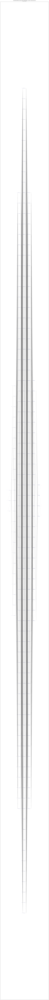

#pruned 0 nodes
Layout is unknown: Multi-partite (default) is used
#fig_size_local: (15.0, 126.0)
#font_size: 7
#node_size: 12


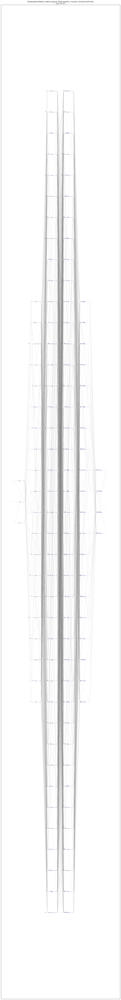

#pruned 0 nodes
Layout is unknown: Multi-partite (default) is used
#fig_size_local: (18.0, 372.0)
#font_size: 7
#node_size: 12


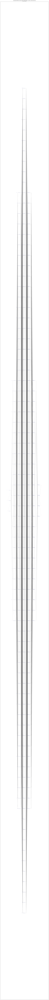

In [ ]:
## draw pattern lattices individually
if draw_individual_lattices:
    if draw_sample_lattices_only:
        Ly = random.sample(Lx, sample_lattice_n)
    else:
        Ly = Lx
    for patlat in Ly:
        patlat.draw_diagrams (generalized = generalized, auto_fig_sizing = True,
                              font_name = multibyte_font_name)

In [ ]:
#raise "Stop execution"

# Process merged pattern lattice

In [ ]:
## merge pattern lattices
import functools
gen_links_internally = False # Cruciall for memory conservation
M = functools.reduce (lambda La, Lb: La.merge_lattices (Lb, gen_links = gen_links_internally, reflexive = reflexive,
                                                        show_steps = True, check = False),
                                                        Lx)

# The following process was isolated for memory conservation
if not gen_links_internally and len(M.links) == 0:
    print(f"#runnning delayed link generation ...")
    M.update_links (reflexive = reflexive, check = False)

#merging pattern lattices ...
#merger running in multi-process mode
#generating links ...
#instantiate: ['…', '…'] to ['…']
#merging pattern lattices ...
#merger running in multi-process mode
#generating links ...
#instantiate: ['…', '…'] to ['…']
#merging pattern lattices ...
#merger running in multi-process mode
#generating links ...
#instantiate: ['…', '…'] to ['…']
#merging pattern lattices ...
#merger running in multi-process mode
#generating links ...
#instantiate: ['…', '…'] to ['…']
#merging pattern lattices ...
#merger running in multi-process mode
#generating links ...
#instantiate: ['…', '…'] to ['…']
#merging pattern lattices ...
#merger running in multi-process mode
#generating links ...
#instantiate: ['…', '…'] to ['…']
#merging pattern lattices ...
#merger running in multi-process mode
#generating links ...
#instantiate: ['…', '…'] to ['…']
#merging pattern lattices ...
#merger running in multi-process mode
#generating links ...
#instantiate: ['…', '…'] to ['…']
#merging

In [ ]:
## calculate z-scores from link sources
if verbose:
    print(f"##Link_sources")
    
Link_sources     = M.link_sources
ranked_links     = plb.make_ranked_dict (Link_sources, gap_mark = gap_mark)
averages_by_rank = plb.calc_averages_by_rank (Link_sources, ranked_links) # returns dict
stdevs_by_rank   = plb.calc_stdevs_by_rank (Link_sources, ranked_links) # returns dict
medians_by_rank  = plb.calc_medians_by_rank (Link_sources, ranked_links) # returns dict
MADs_by_rank     = plb.calc_MADs_by_rank (Link_sources, ranked_links) # returns dict

## calculate z-scores
source_zscores = { }
robust_zscores_from_s   = [ ] # for inspection only
normal_zscores_from_s   = [ ] # for inspection only
for i, link_source in enumerate(Link_sources):
    rank     = plb.get_rank_of_list (link_source, gap_mark)
    value    = M.link_sources[link_source]
    
    ## robust z-scores
    robust_zscore  = plb.calc_zscore (value, averages_by_rank[rank], stdevs_by_rank[rank], medians_by_rank[rank], MADs_by_rank[rank], robust = True)
    robust_zscores_from_s.append(robust_zscore)
    
    ## normal z-scores
    normal_zscore   = plb.calc_zscore_old (value, averages_by_rank[rank], stdevs_by_rank[rank])
    normal_zscores_from_s.append(normal_zscore)

    if use_robust_zscore:
        source_zscores[link_source] = robust_zscore
    else:
        source_zscores[link_source] = normal_zscore
    if verbose:
        print(f"#source {i:4d}: {link_source} has {value} out-going(s) [{source_zscores[link_source]: .4f} at rank {rank}]")
    
## attach source_zscores to M
M.source_zscores.update(source_zscores)

##Link_sources
#source    0: ('…', '…', '…') has 205 out-going(s) [ 1.7325 at rank 0]
#source    1: ('…', '…', '…', '…') has 103 out-going(s) [ 0.3835 at rank 0]
#source    2: ('…', '…', '…', '…', '…') has 45 out-going(s) [-0.3835 at rank 0]
#source    3: ('…', '…', '…', '…', '…', '…') has 1 out-going(s) [-0.9655 at rank 0]
#source    4: ('i', '…', '…') has 21 out-going(s) [-0.7615 at rank 1]
#source    5: ('…', 's', '…') has 185 out-going(s) [ 2.8068 at rank 1]
#source    6: ('…', '…', 'l') has 325 out-going(s) [ 5.8529 at rank 1]
#source    7: ('…', 's', '…', '…') has 136 out-going(s) [ 1.7406 at rank 1]
#source    8: ('…', '…', '…', 'e') has 168 out-going(s) [ 2.4369 at rank 1]
#source    9: ('…', '…', 'l', '…') has 360 out-going(s) [ 6.6145 at rank 1]
#source   10: ('…', '…', '…', 'e', '…') has 1 out-going(s) [-1.1967 at rank 1]
#source   11: ('…', '…', 'l', '…', '…') has 147 out-going(s) [ 1.9800 at rank 1]
#source   12: ('…', 'o', '…') has 25 out-going(s) [-0.6745 at rank 1]
#sou

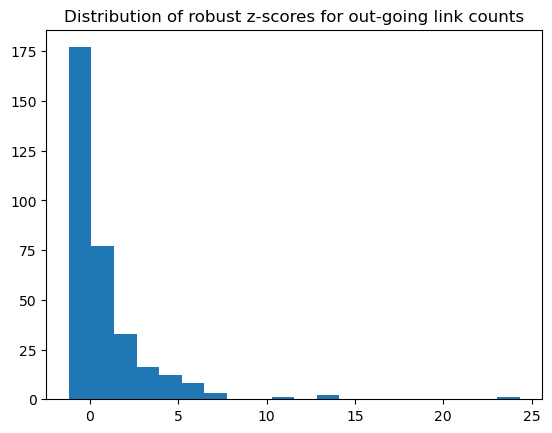

In [ ]:
## check robust z-score distribution
import matplotlib.pyplot as plt
plt.hist(robust_zscores_from_s, bins = 20)
plt.title(f"Distribution of robust z-scores for out-going link counts")
plt.show()

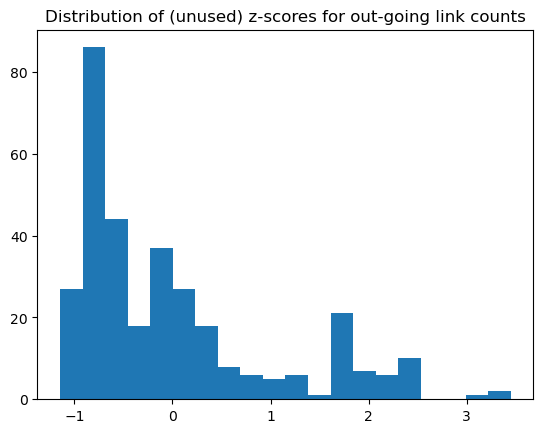

In [ ]:
## check robust z-score distribution
import matplotlib.pyplot as plt
plt.hist(normal_zscores_from_s, bins = 20)
plt.title(f"Distribution of (unused) z-scores for out-going link counts")
plt.show()

In [ ]:
## calculate z-scores from link targets
if verbose:
    print(f"##Link_targets")

Link_targets     = M.link_targets
ranked_links     = plb.make_ranked_dict (Link_targets, gap_mark = gap_mark)
averages_by_rank = plb.calc_averages_by_rank (Link_targets, ranked_links) # returns dict
stdevs_by_rank   = plb.calc_stdevs_by_rank (Link_targets, ranked_links) # returns dict
medians_by_rank  = plb.calc_medians_by_rank (Link_targets, ranked_links) # returns dict
MADs_by_rank     = plb.calc_MADs_by_rank (Link_targets, ranked_links) # returns dict

## calculate z-scores
target_zscores = { }
robust_zscores_from_t  = [ ] # for inspection only
normal_zscores_from_t  = [ ] # for inspection only
for i, link_target in enumerate(Link_targets):
    rank     = plb.get_rank_of_list (link_target, gap_mark)
    value    = Link_targets[link_target]
    ## robust z-scores
    robust_zscore  = plb.calc_zscore (value,
                                      averages_by_rank[rank], stdevs_by_rank[rank], medians_by_rank[rank], MADs_by_rank[rank], robust = True)
    robust_zscores_from_t.append(robust_zscore)
    ## tracking z-scores
    normal_zscore   = plb.calc_zscore_old (value,
                                           averages_by_rank[rank], stdevs_by_rank[rank])
    normal_zscores_from_t.append(normal_zscore)
    if use_robust_zscore:
        target_zscores[link_target] = robust_zscore
    else:
        target_zscores[link_target] = normal_zscore
    if verbose:
        print(f"#target {i}: {link_target} has {value} in-coming(s) [{target_zscores[link_target]: .4f} at rank {rank}]")

## attach source_zscores to M
M.target_zscores.update(target_zscores)

##Link_targets
#target 0: ('i', '…', '…') has 52 in-coming(s) [ 33.7250 at rank 1]
#target 1: ('…', 's', '…') has 10 in-coming(s) [ 5.3960 at rank 1]
#target 2: ('…', '…', 'l') has 24 in-coming(s) [ 14.8390 at rank 1]
#target 3: ('…', 'o', '…') has 7 in-coming(s) [ 3.3725 at rank 1]
#target 4: ('…', '…', '…') has 18 in-coming(s) [ 2.1921 at rank 0]
#target 5: ('…', 's', '…', '…') has 2 in-coming(s) [ 0.0000 at rank 1]
#target 6: ('…', '…', '…', 'e') has 4 in-coming(s) [ 1.3490 at rank 1]
#target 7: ('…', '…', 'l', '…') has 4 in-coming(s) [ 1.3490 at rank 1]
#target 8: ('…', '…', 'o', '…') has 4 in-coming(s) [ 1.3490 at rank 1]
#target 9: ('g', '…', '…', '…') has 2 in-coming(s) [ 0.0000 at rank 1]
#target 10: ('…', '…', '…', '…') has 5 in-coming(s) [ 0.0000 at rank 0]
#target 11: ('…', '…', '…', 'e', '…') has 5 in-coming(s) [ 2.0235 at rank 1]
#target 12: ('…', '…', 'l', '…', '…') has 2 in-coming(s) [ 0.0000 at rank 1]
#target 13: ('…', '…', 'o', '…', '…') has 2 in-coming(s) [ 0.0000 at

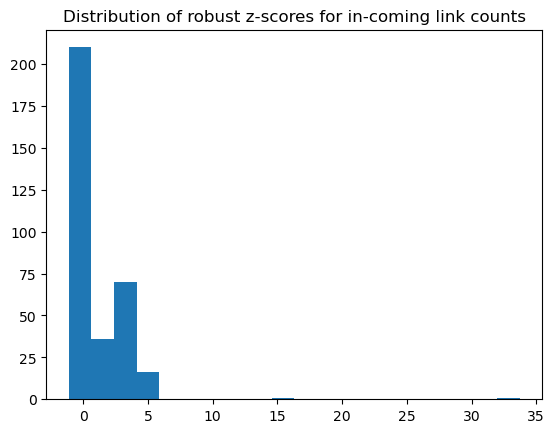

In [ ]:
## check z-score distribution
import matplotlib.pyplot as plt
plt.hist(robust_zscores_from_t, bins = 20)
plt.title(f"Distribution of robust z-scores for in-coming link counts")
plt.show()

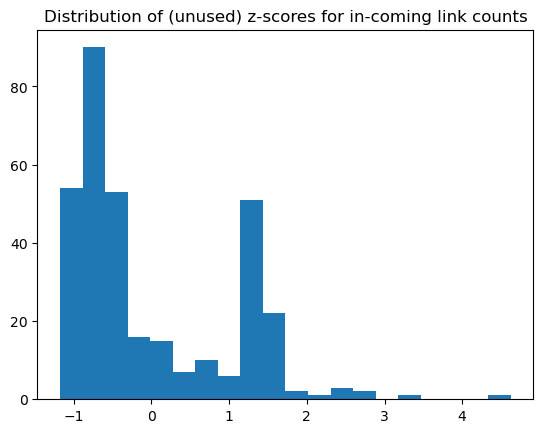

In [ ]:
## check z-score distribution
import matplotlib.pyplot as plt
plt.hist(normal_zscores_from_t, bins = 20)
plt.title(f"Distribution of (unused) z-scores for in-coming link counts")
plt.show()

In [ ]:
## select z-score base
if zscores_from_sources:
    Link_bases = M.source_zscores
else:
    Link_bases = M.target_zscores
## check result
i = 0
for key, value in Link_bases.items():
    i += 1
    print(f"node {i:3d} {key} has z-score: {value: .4f}")

node   1 ('…', '…', '…') has z-score:  1.7325
node   2 ('…', '…', '…', '…') has z-score:  0.3835
node   3 ('…', '…', '…', '…', '…') has z-score: -0.3835
node   4 ('…', '…', '…', '…', '…', '…') has z-score: -0.9655
node   5 ('i', '…', '…') has z-score: -0.7615
node   6 ('…', 's', '…') has z-score:  2.8068
node   7 ('…', '…', 'l') has z-score:  5.8529
node   8 ('…', 's', '…', '…') has z-score:  1.7406
node   9 ('…', '…', '…', 'e') has z-score:  2.4369
node  10 ('…', '…', 'l', '…') has z-score:  6.6145
node  11 ('…', '…', '…', 'e', '…') has z-score: -1.1967
node  12 ('…', '…', 'l', '…', '…') has z-score:  1.9800
node  13 ('…', 'o', '…') has z-score: -0.6745
node  14 ('…', '…', 'o', '…') has z-score:  1.0661
node  15 ('…', '…', 'o', '…', '…') has z-score: -0.7615
node  16 ('…', '…', '…', 'o', '…') has z-score:  0.6092
node  17 ('…', 'l', '…', '…', '…') has z-score:  0.6092
node  18 ('…', '…', 'e', '…', '…') has z-score:  0.6092
node  19 ('g', '…', '…', '…') has z-score:  0.0000
node  20 ('

pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', 'e', 'r', '…') with z-score -0.9858
pruned node ('c', 'u', 'l', 'l', '

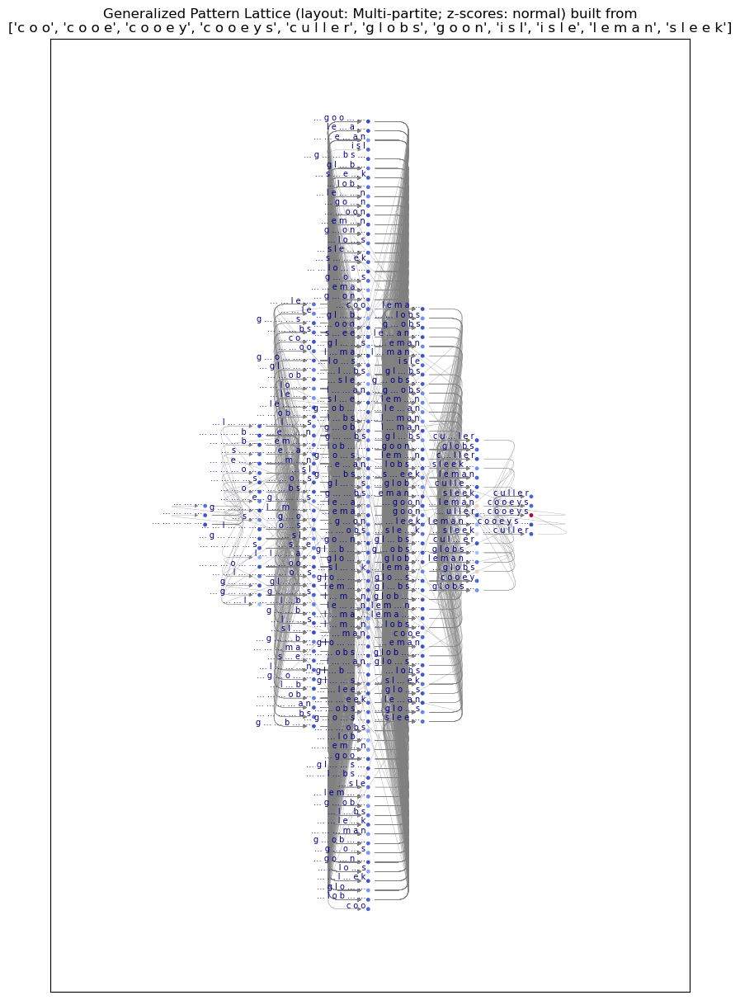

In [ ]:
## draw a pruned diagram from the merged lattice
graph_layouts = [   'Multi_partite', # 0
                    'Graphviz', # 1
                    'ARF', # 2
                    'Fruchterman_Reingold', # 3
                    'Kamada_Kawai', # 4
                    'Spring', # 5
                    'Shell', # 6
                    'Spectral', # 7
                    'Circular', # 8
                    'Planar' # 9 # often fails
                 ]
##
layout             = graph_layouts[0]
scale_factor       = 3
zscore_lowerbound  = -0.5

manually_set = True
if manually_set:
   M.draw_diagrams (generalized = generalized, layout = layout, auto_fig_sizing = False, fig_size = (10, 15),
                    label_sample_n = 4, label_size = 16, node_size = 52,
                    font_name = multibyte_font_name, zscore_lowerbound = zscore_lowerbound,
                    scale_factor = scale_factor, check = False)
else:
   M.draw_diagrams (generalized = generalized, layout = layout, auto_fig_sizing = True, label_sample_n = 4,
                    zscore_lowerbound = zscore_lowerbound,
                    scale_factor = scale_factor, font_name = multibyte_font_name, check = False)

In [ ]:
## draw a full diagram from the merged lattice
if draw_full_version_for_merged:
    layout = graph_layouts[0]
    zscore_lowerbound  = None
    scale_factor       = 3
    ##
    adjusted = False
    if adjusted:
        M.draw_diagrams (layout = layout, zscore_lowerbound = zscore_lowerbound,
        scale_factor = scale_factor, fig_size = (24, 60), label_size = 12, node_size = 33, font_name = multibyte_font_name, check = False)
    else:
        M.draw_diagrams (layout = layout, zscore_lowerbound = zscore_lowerbound,
        scale_factor = scale_factor, font_name = multibyte_font_name, check = False)